In [10]:
import cv2

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


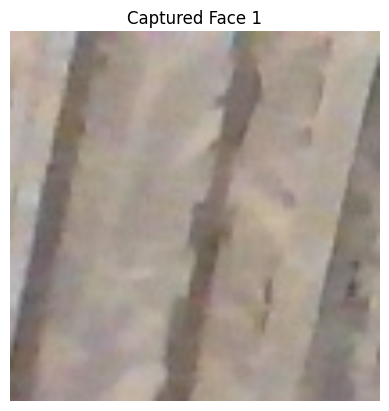

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


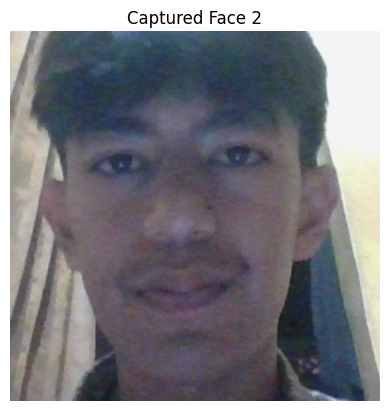

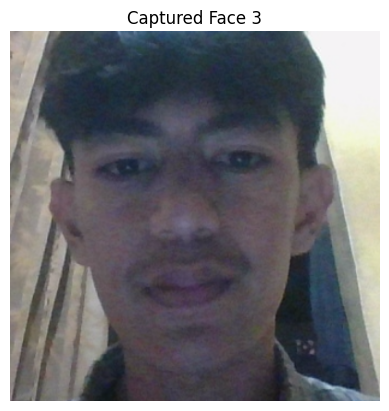

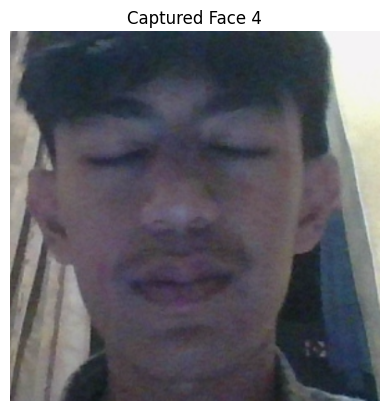

Face not found


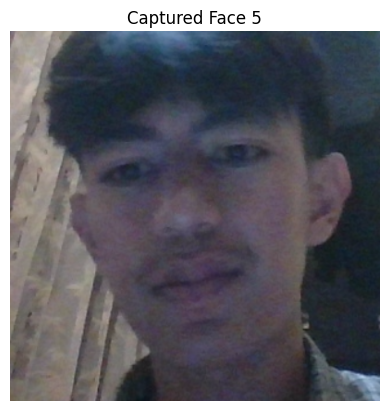

Face not found


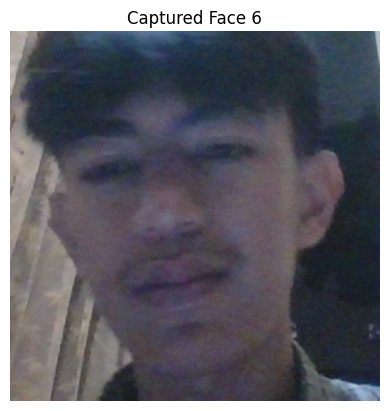

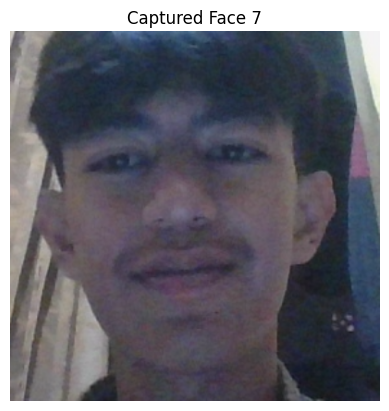

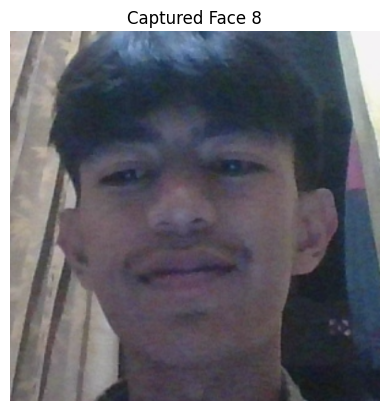

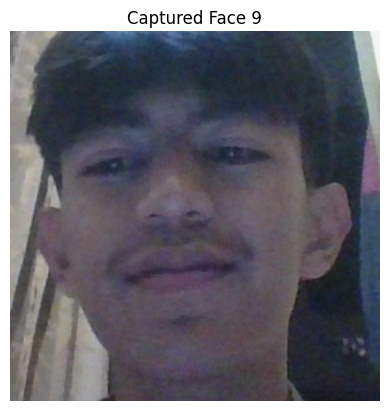

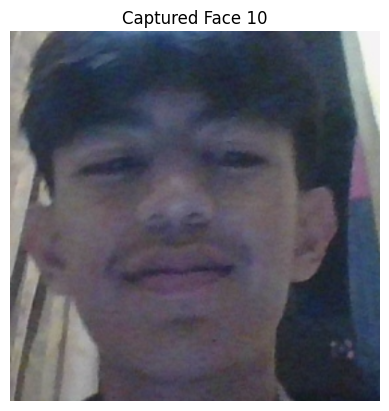

...

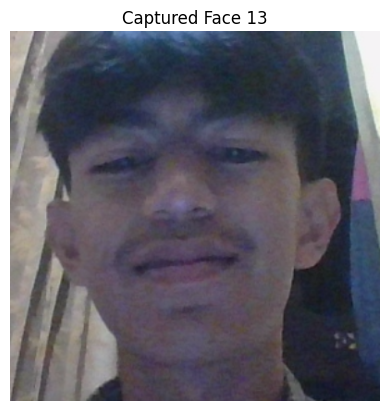

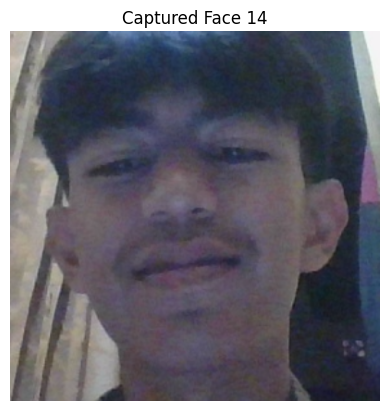

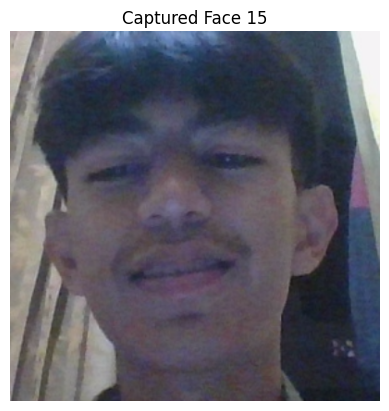

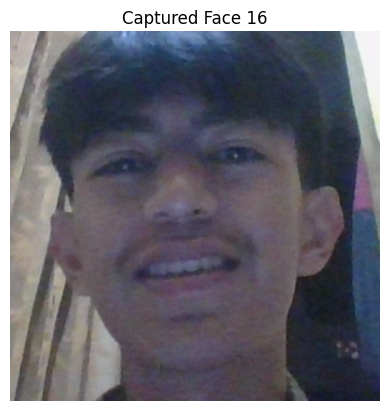

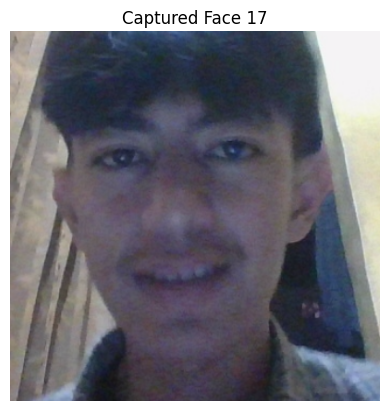

Face not found
Face not found
Face not found


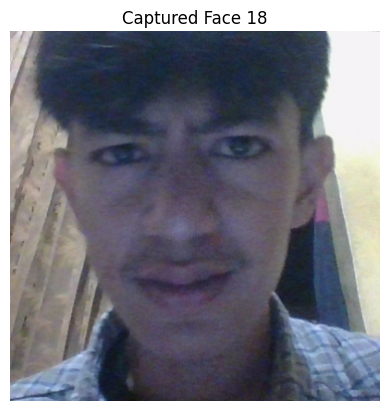

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


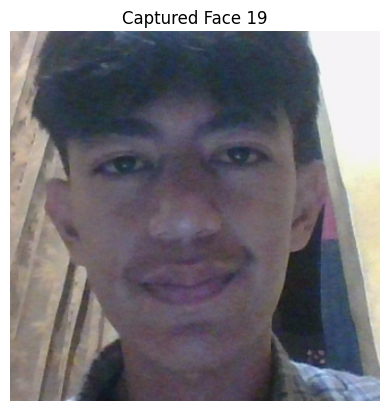

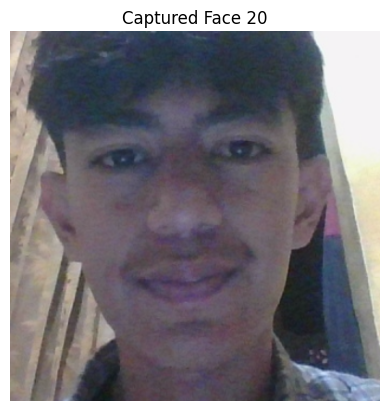

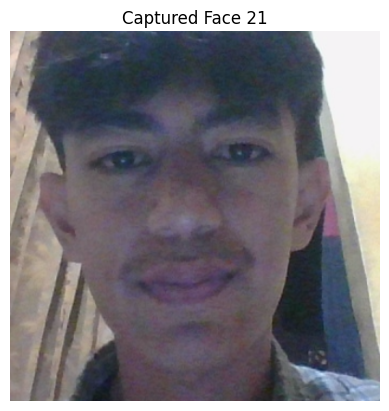

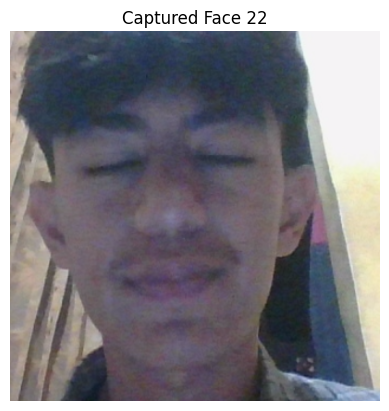

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


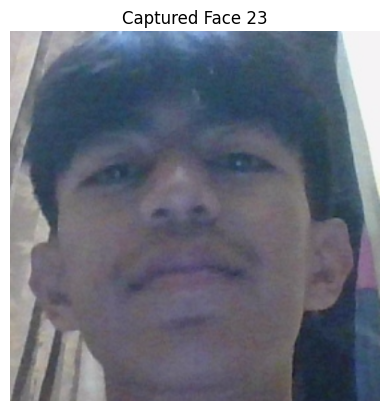

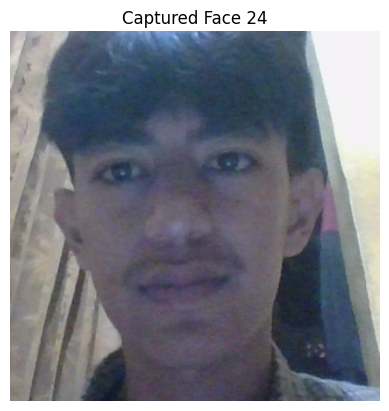

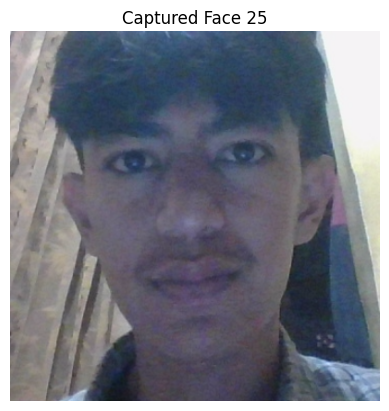

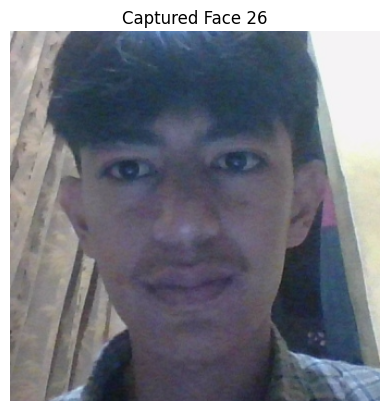

Face not found


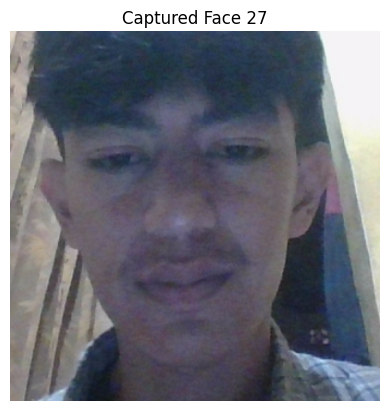

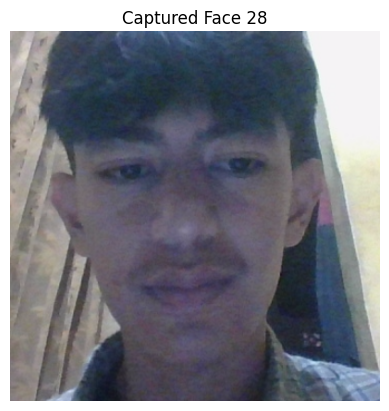

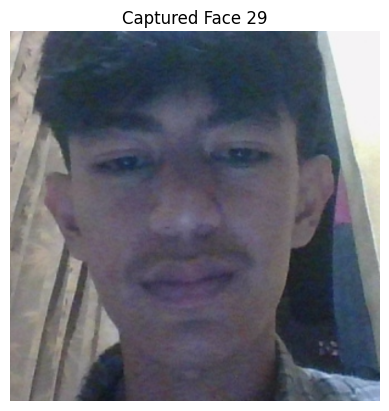

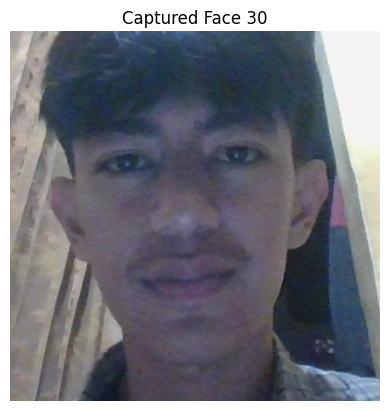

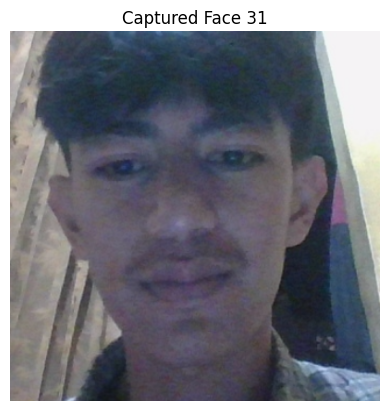

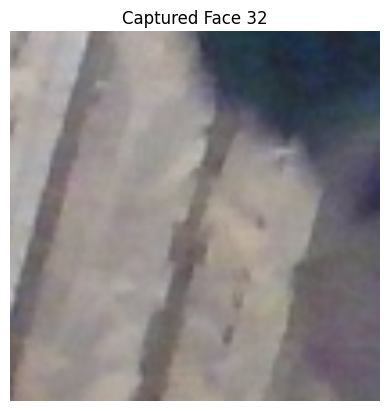

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


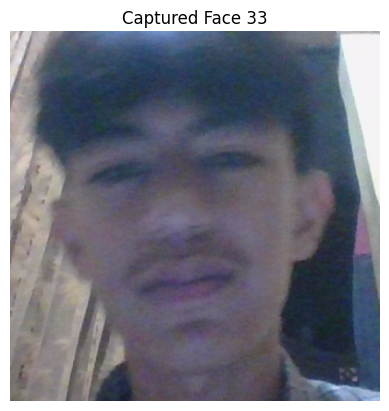

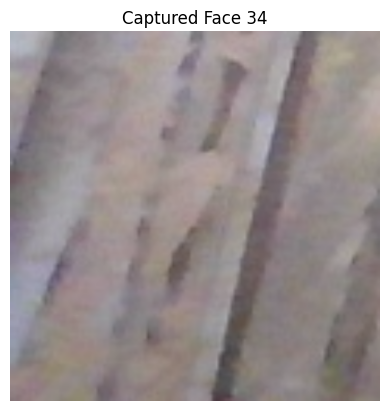

Face not found
Face not found
Face not found


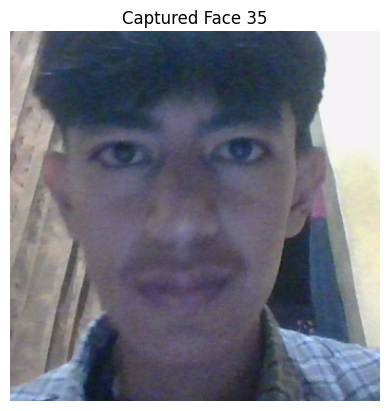

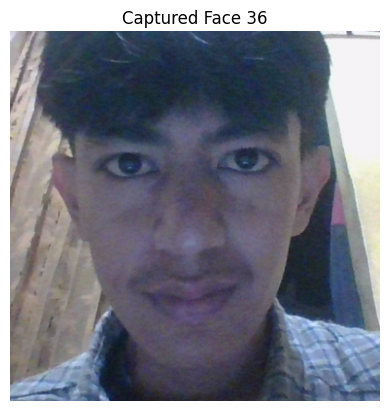

Face not found
Face not found
Face not found
Face not found
Face not found


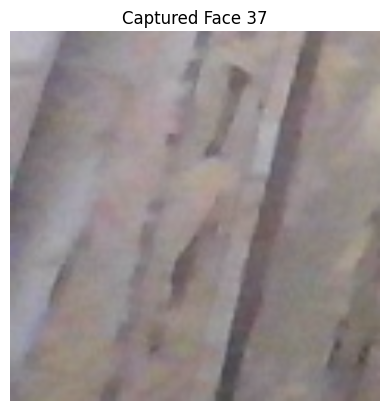

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


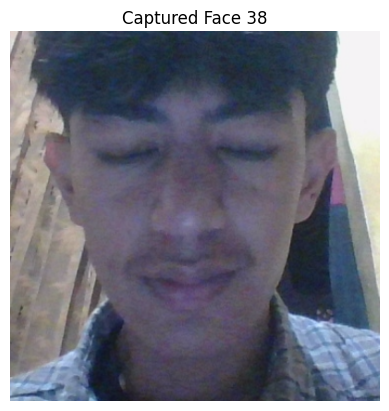

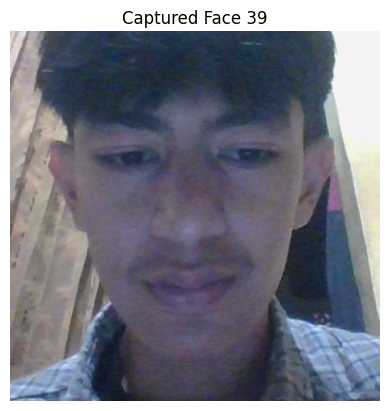

Face not found
Face not found


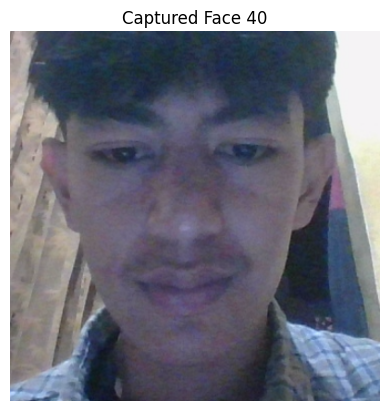

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


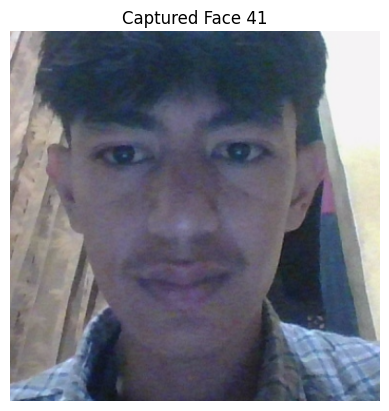

Face not found
Face not found


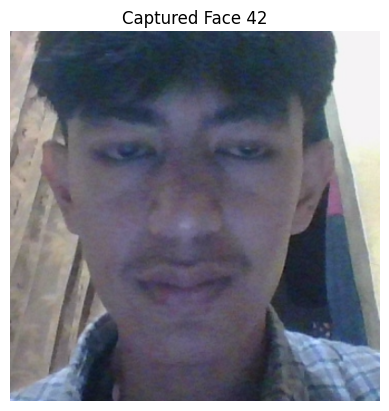

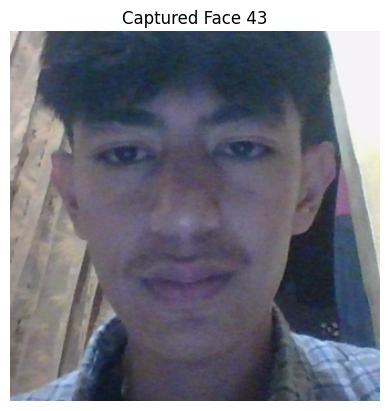

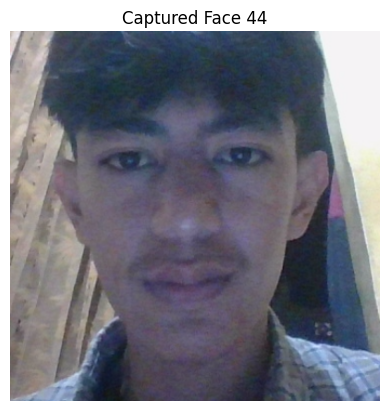

Face not found


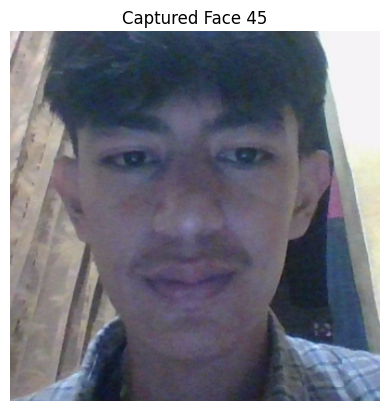

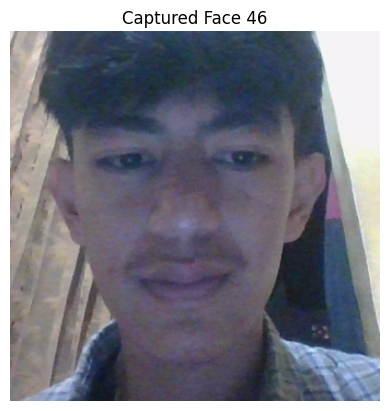

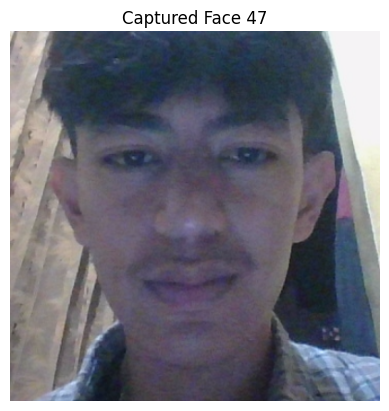

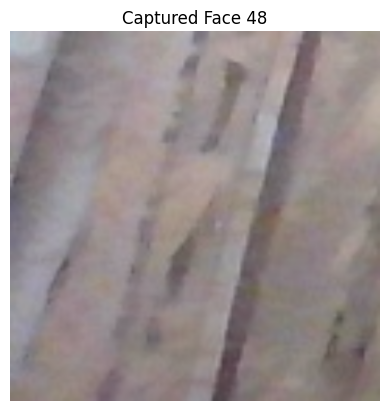

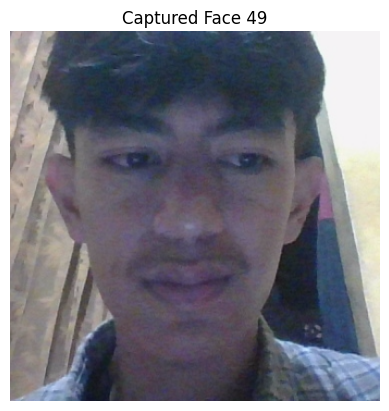

Face not found
Face not found


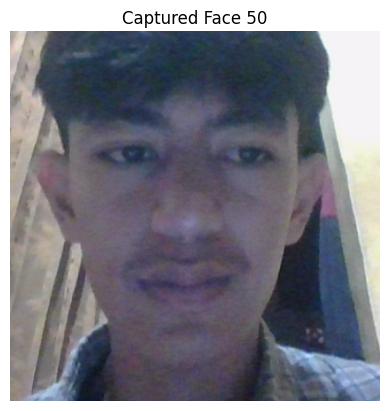

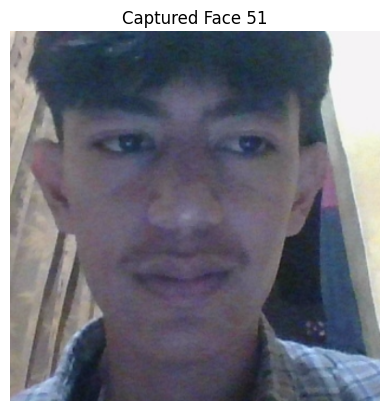

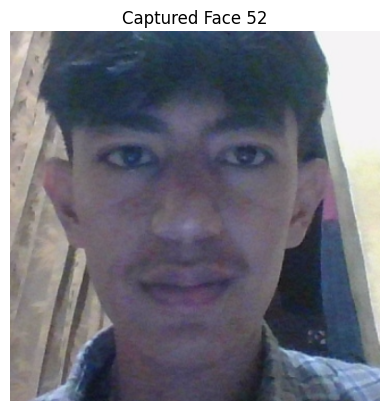

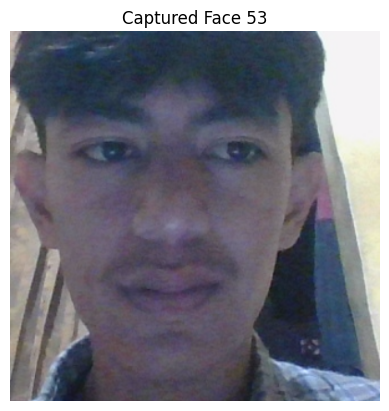

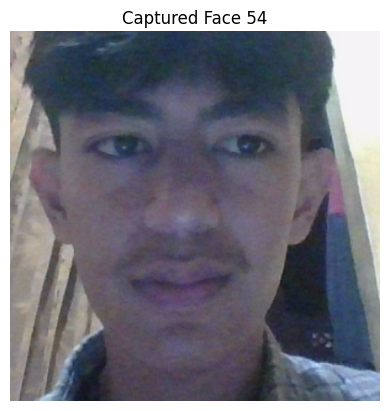

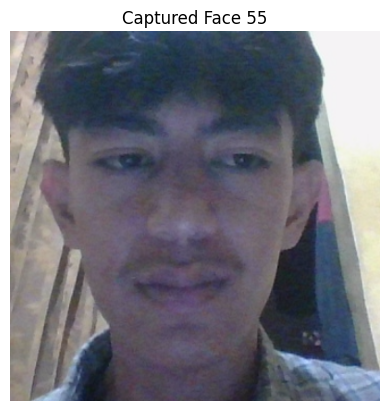

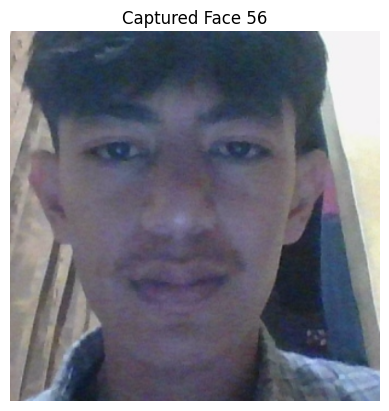

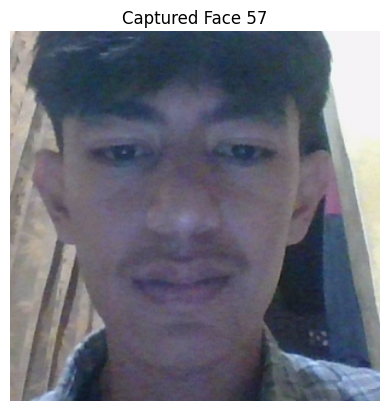

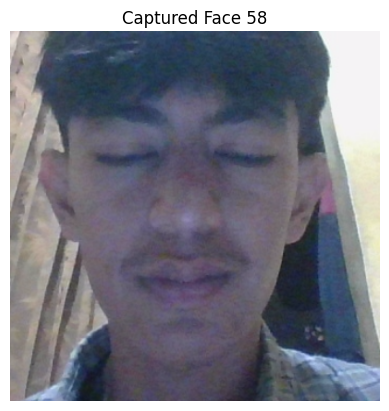

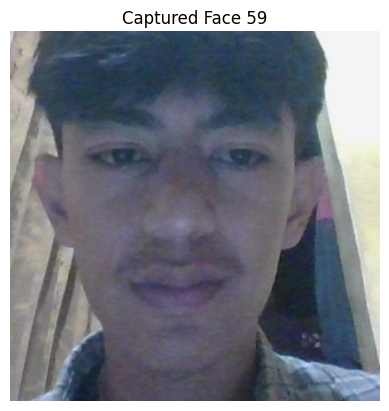

Face not found


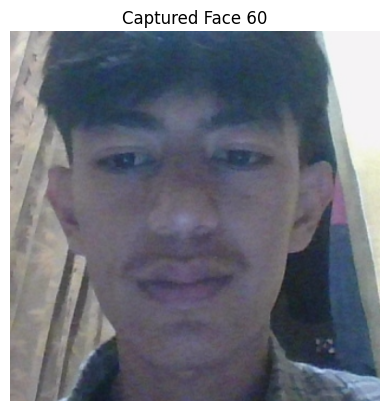

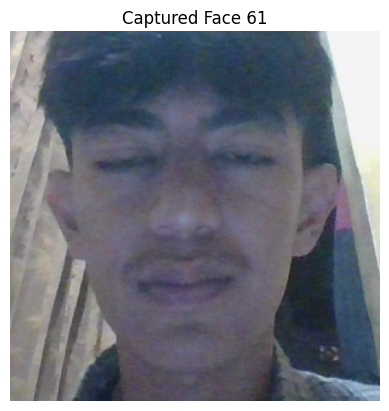

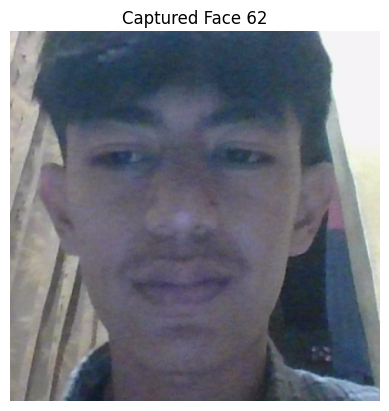

Face not found
Face not found


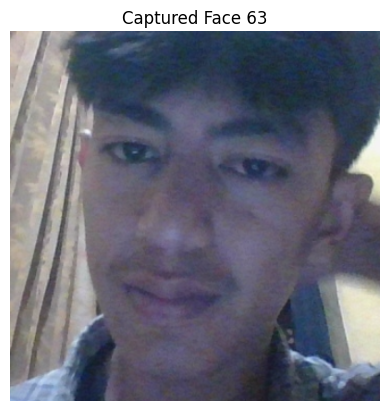

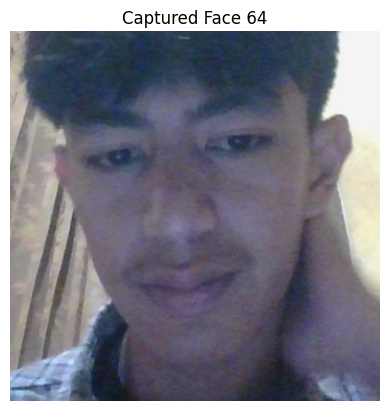

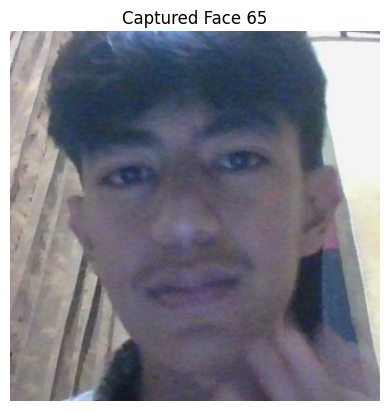

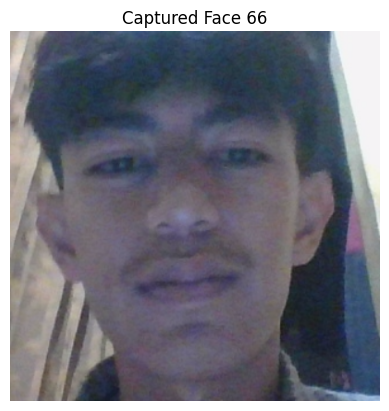

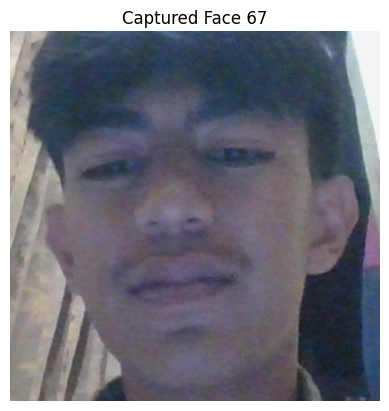

Face not found
Face not found
Face not found
Face not found


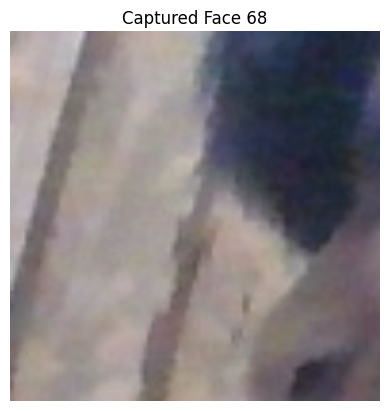

Face not found


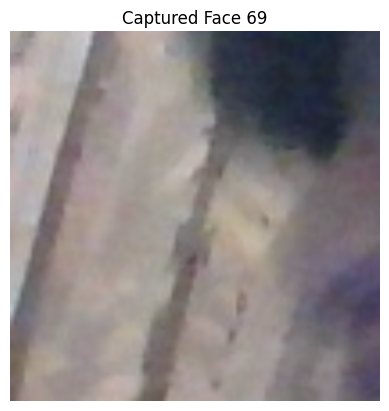

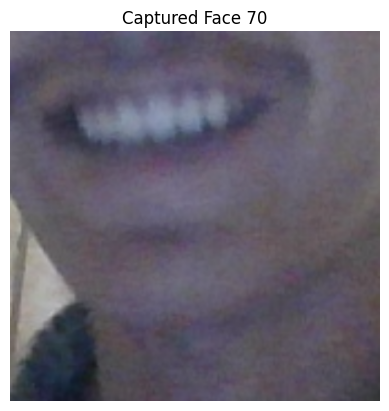

Face not found


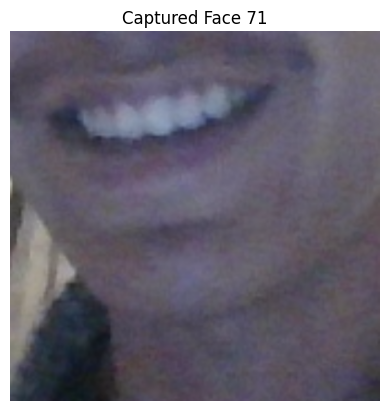

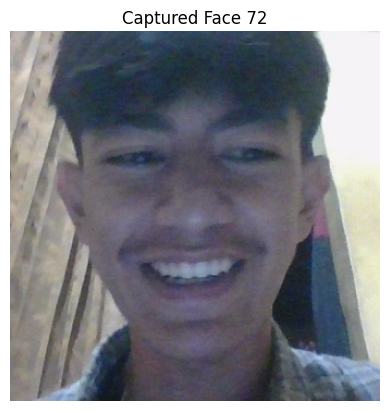

Face not found


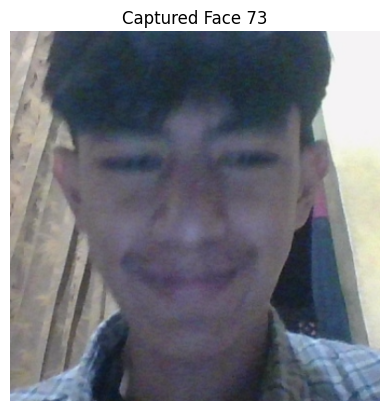

Face not found
Face not found
Face not found


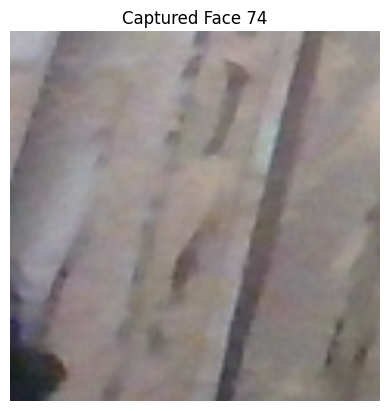

Face not found
Face not found
Face not found
Face not found
Face not found


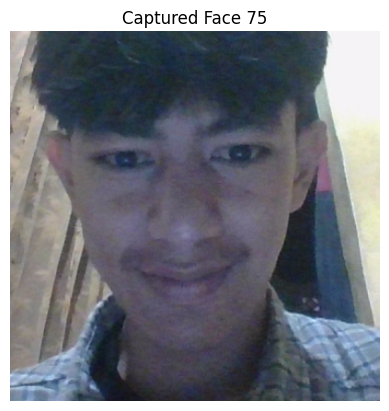

Face not found


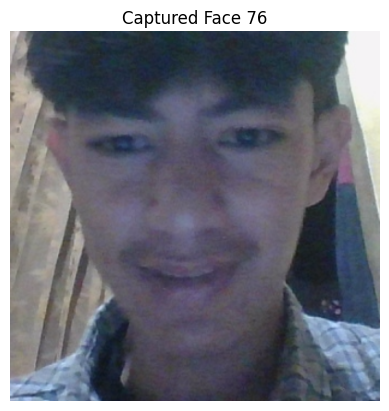

Face not found
Face not found
Face not found


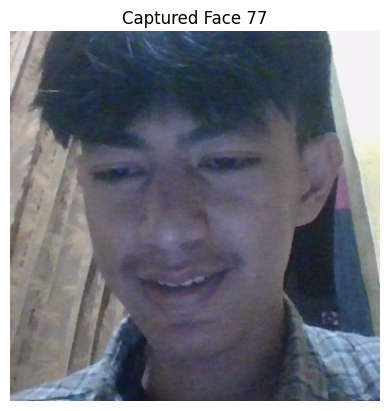

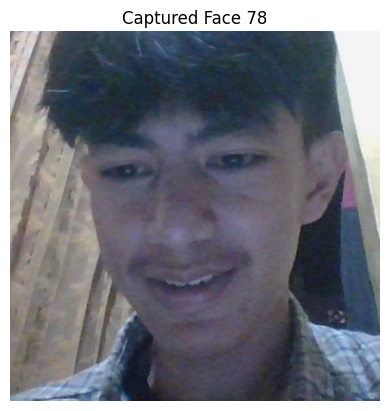

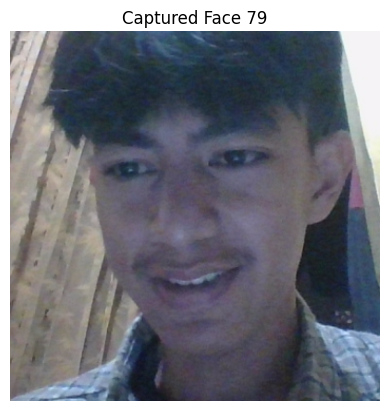

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


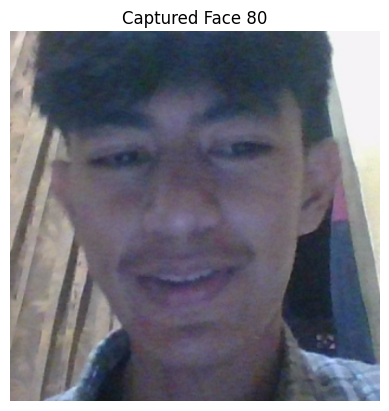

Face not found
Face not found
Face not found


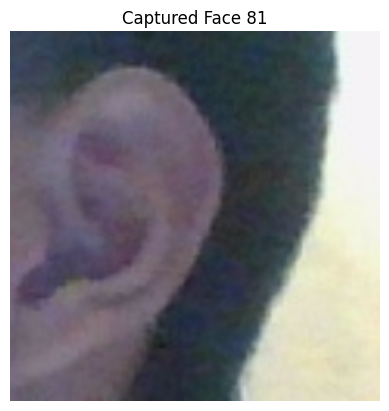

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


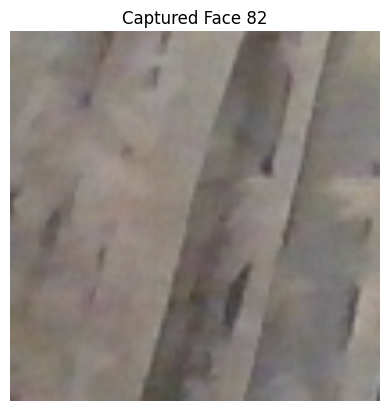

Face not found
Face not found
Face not found
Face not found


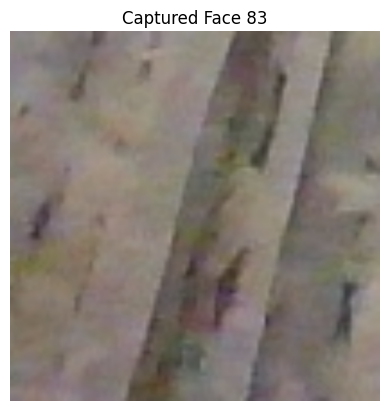

Face not found
Face not found
Face not found


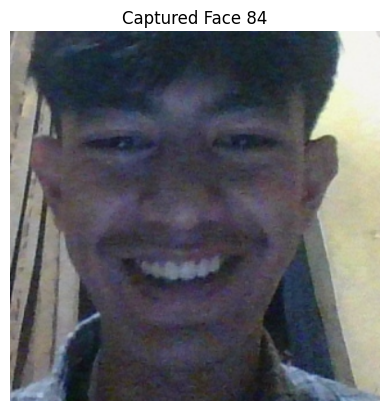

Face not found


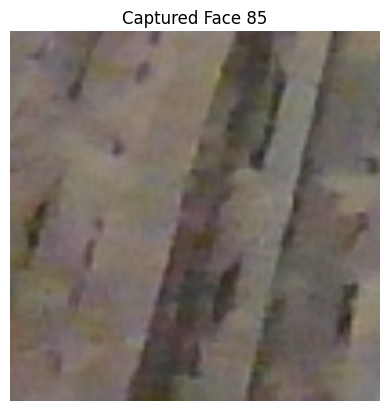

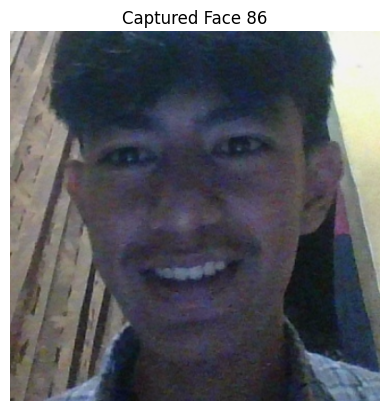

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


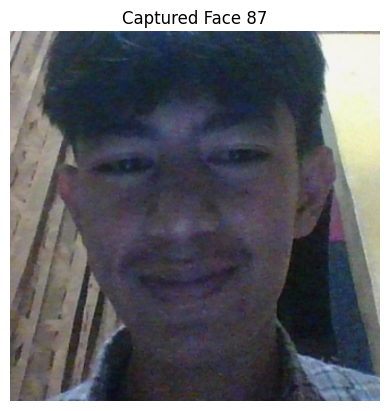

Face not found
Face not found
Face not found
Face not found


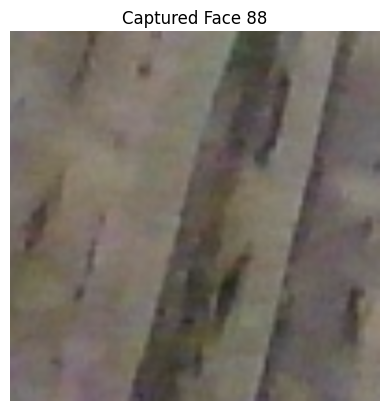

Face not found
Face not found


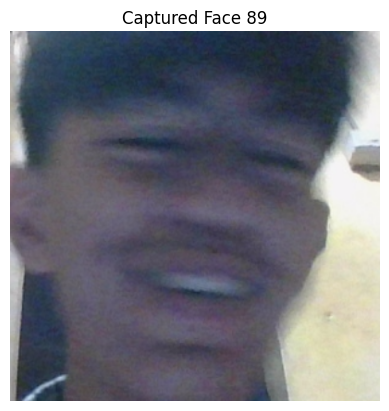

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


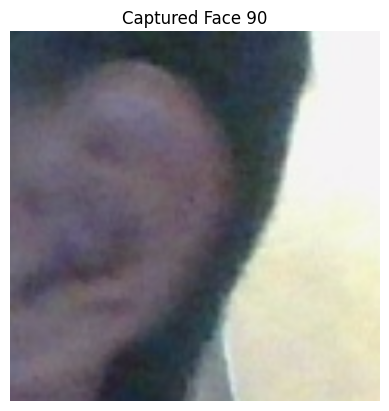

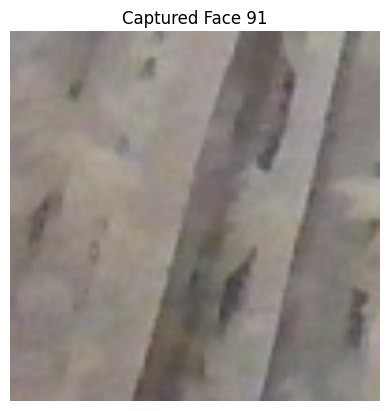

Face not found


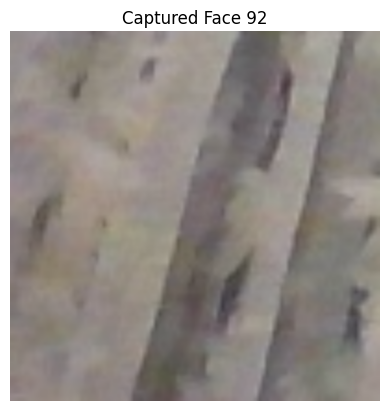

Face not found
Face not found
Face not found


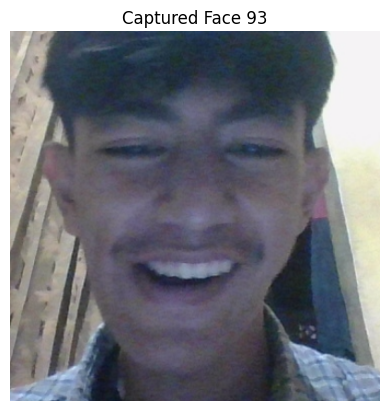

Face not found
Face not found
Face not found


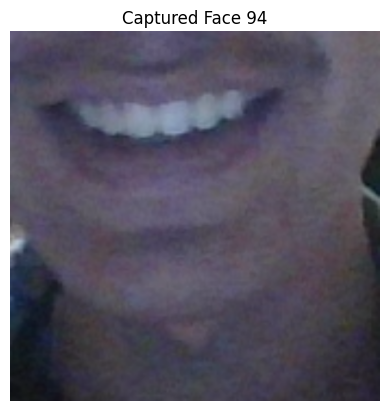

Face not found
Face not found


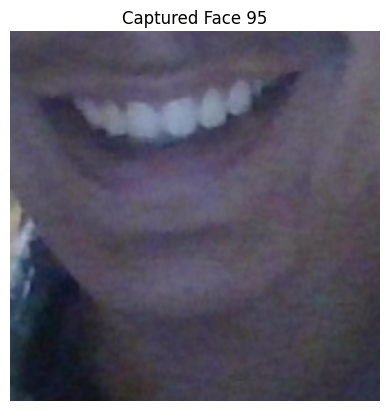

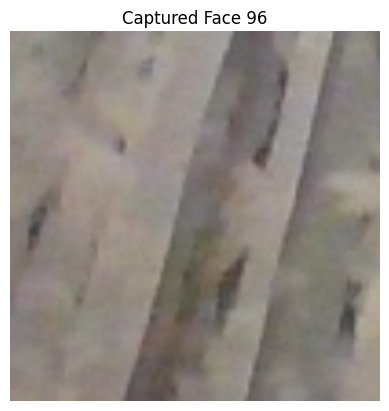

Face not found
Face not found


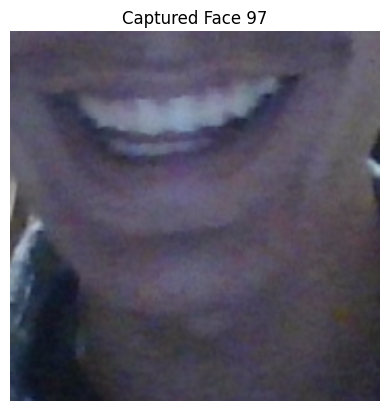

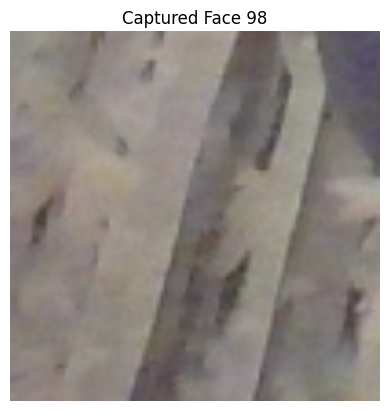

Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found
Face not found


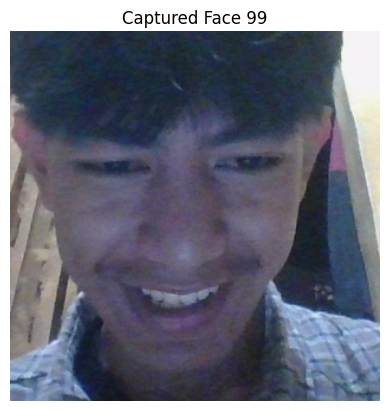

Face not found
Face not found
Face not found


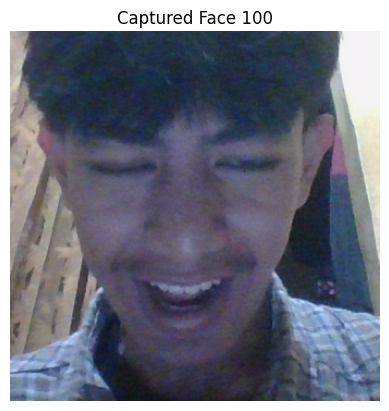

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load HAAR face classifier
face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Load functions
def face_extractor(img):
    # Function detects faces and returns the cropped face
    # If no face detected, it returns None
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    
    if len(faces) == 0:
        return None
    
    # Crop the first face found
    for (x, y, w, h) in faces:
        x = max(x - 10, 0)
        y = max(y - 10, 0)
        cropped_face = img[y:y + h + 50, x:x + w + 50]
        return cropped_face

# Initialize Webcam
cap = cv2.VideoCapture(0)
count = 0

# Collect 100 samples of your face from webcam input
while True:
    ret, frame = cap.read()
    if not ret:
        print("Failed to capture frame")
        break

    face = face_extractor(frame)
    if face is not None:
        count += 1
        face = cv2.resize(face, (400, 400))  # Resize the face

        # Save file in the specified directory with a unique name
        file_name_path = f'D:/aldisetiawan/Semester 5/Computer Vision/sesi_11/Dataset/aldi.{count}.jpg'
        cv2.imwrite(file_name_path, face)

        # Display the face in Jupyter Notebook
        plt.imshow(cv2.cvtColor(face, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f'Captured Face {count}')
        plt.show()

    else:
        print("Face not found")
        pass

    if count == 100:  # Stop after collecting 100 samples
        break

cap.release()
print("Collecting Samples Complete")


In [12]:
import cv2
import os

# Load HAAR face classifier
face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Cek apakah classifier berhasil dimuat
if face_classifier.empty():
    raise ValueError("Error loading haarcascade_frontalface_default.xml")

# Fungsi untuk mendeteksi dan memotong wajah
def face_extractor(img):
    # Konversi gambar ke grayscale untuk meningkatkan akurasi deteksi
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_classifier.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=4)
    
    if len(faces) == 0:
        return None  # Jika tidak ada wajah terdeteksi, kembalikan None
    
    # Potong wajah pertama yang terdeteksi
    for (x, y, w, h) in faces:
        x = max(x - 10, 0)
        y = max(y - 10, 0)
        cropped_face = img[y:y + h + 50, x:x + w + 50]
        return cropped_face

# Inisialisasi kamera
cap = cv2.VideoCapture(1)
if not cap.isOpened():
    raise RuntimeError("Kamera gagal diakses")

# Direktori penyimpanan gambar
output_dir = 'D:/aldisetiawan/Semester 5/Computer Vision/sesi_11/Dataset'
os.makedirs(output_dir, exist_ok=True)  # Buat direktori jika belum ada

count = 0  # Hitung jumlah wajah yang berhasil disimpan

print("Mulai pengumpulan sampel wajah. Tekan 'q' untuk keluar.")

# Loop untuk menangkap gambar
while True:
    ret, frame = cap.read()
    if not ret:
        print("Gagal menangkap frame")
        break

    # Deteksi wajah
    face = face_extractor(frame)
    if face is not None:
        count += 1
        face = cv2.resize(face, (400, 400))  # Ubah ukuran wajah menjadi 400x400

        # Simpan file dengan nama unik
        file_name_path = os.path.join(output_dir, f'Image_{count}.jpg')
        cv2.imwrite(file_name_path, face)

        # Tampilkan wajah yang terdeteksi
        cv2.imshow('Captured Face', face)
    else:
        print("Wajah tidak ditemukan")
    
    # Hentikan jika sudah 100 wajah atau jika 'q' ditekan
    if count == 100:
        print("Pengumpulan sampel selesai")
        break
    
    if cv2.waitKey(1) & 0xFF == ord('q'):  # Tekan 'q' untuk keluar
        print("Pengumpulan dihentikan oleh pengguna")
        break

# Bebaskan resource
cap.release()
cv2.destroyAllWindows()

Mulai pengumpulan sampel wajah. Tekan 'q' untuk keluar.
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemukan
Wajah tidak ditemuka

KeyboardInterrupt: 

In [4]:
import cv2

cap = cv2.VideoCapture(0)
if not cap.isOpened():
    print("Camera not accessible")
else:
    print("Camera is accessible")
    cap.release()


Camera is accessible
